In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
from joblib import Parallel, delayed
#import umap
import pandas as pd

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [3]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir

In [4]:
DATASET_ID = 'katahira_white_munia_segmented'

In [5]:
from avgn.utils.hparams import HParams
from avgn.dataset import DataSet

In [6]:
from avgn.signalprocessing.create_spectrogram_dataset import prepare_wav, create_label_df, get_row_audio

### create dataset

In [8]:
hparams = HParams(
    num_mel_bins = 32,
    mel_lower_edge_hertz=500,
    mel_upper_edge_hertz=10000,
    butter_lowcut = 500,
    butter_highcut = 10000,
    ref_level_db = 20,
    min_level_db = -25,
    mask_spec = True,
    win_length_ms = 10,
    hop_length_ms = 2,
    mask_spec_kwargs = {"spec_thresh": 0.9, "offset": 1e-10},
    nex=-1,
    n_jobs=-1,
    verbosity = 1,
)

In [9]:
# create a dataset object
dataset = DataSet(DATASET_ID, hparams = hparams)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   11.4s


[Parallel(n_jobs=-1)]: Done 122 out of 169 | elapsed:   11.7s remaining:    4.5s
[Parallel(n_jobs=-1)]: Done 169 out of 169 | elapsed:   11.7s finished


In [10]:
dataset.sample_json

OrderedDict([('species', 'Lonchura striata'),
             ('common_name', 'White rumped munia'),
             ('wav_loc', '/mnt/cube/Datasets/WhiteMunia/WM/WM24/11.WAV'),
             ('samplerate_hz', 48000),
             ('length_s', 11.4706875),
             ('wav_num', '11'),
             ('indvs',
              OrderedDict([('WM24',
                            OrderedDict([('syllables',
                                          OrderedDict([('start_times',
                                                        [1.17,
                                                         1.19,
                                                         1.77,
                                                         2.016,
                                                         2.38,
                                                         2.4,
                                                         2.596,
                                                         2.688,
                           

In [11]:
len(dataset.data_files)

169

#### Create dataset based upon JSON

In [12]:
from joblib import Parallel, delayed
n_jobs = -1; verbosity = 10

In [13]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllable_dfs = parallel(
        delayed(create_label_df)(
            dataset.data_files[key].data,
            hparams=dataset.hparams,
            labels_to_retain=[],
            unit="syllables",
            dict_features_to_retain = [],
            key = key,
        )
        for key in tqdm(dataset.data_files.keys())
    )
syllable_df = pd.concat(syllable_dfs)
len(syllable_df)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done  50 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done  65 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done  80 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:    4.9s


[Parallel(n_jobs=-1)]: Done 139 out of 169 | elapsed:    5.1s remaining:    1.1s
[Parallel(n_jobs=-1)]: Done 156 out of 169 | elapsed:    5.2s remaining:    0.4s
[Parallel(n_jobs=-1)]: Done 169 out of 169 | elapsed:    5.2s finished


111500

In [14]:
syllable_df[:3]

,start_time,end_time,indv,indvi,key
0,1.17,1.182,WM24,0,WM24_11
1,1.19,1.200,WM24,0,WM24_11
2,1.77,1.802,WM24,0,WM24_11


### get audio for dataset

In [15]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllable_dfs = parallel(
        delayed(get_row_audio)(
            syllable_df[syllable_df.key == key], 
            dataset.data_files[key].data['wav_loc'], 
            dataset.hparams
        )
        for key in tqdm(syllable_df.key.unique())
    )
syllable_df = pd.concat(syllable_dfs)
len(syllable_df)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done  50 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done  65 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done  80 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:    6.2s


[Parallel(n_jobs=-1)]: Done 139 out of 169 | elapsed:    7.8s remaining:    1.7s
[Parallel(n_jobs=-1)]: Done 156 out of 169 | elapsed:    8.5s remaining:    0.7s
[Parallel(n_jobs=-1)]: Done 169 out of 169 | elapsed:    9.3s finished


111500

In [16]:
df_mask  = np.array([len(i) > 0 for i in tqdm(syllable_df.audio.values)])

In [17]:
syllable_df = syllable_df[np.array(df_mask)]

In [18]:
syllable_df[:3]

,start_time,end_time,indv,indvi,key,audio,rate
0,1.17,1.182,WM24,0,WM24_11,"[-0.014757872657941751, -0.026072724128413452,...",48000
1,1.19,1.200,WM24,0,WM24_11,"[-0.03453265964816564, -0.028893295792701952, ...",48000
2,1.77,1.802,WM24,0,WM24_11,"[0.07076041801060257, 0.011244196025488713, -0...",48000


In [19]:
sylls = syllable_df.audio.values

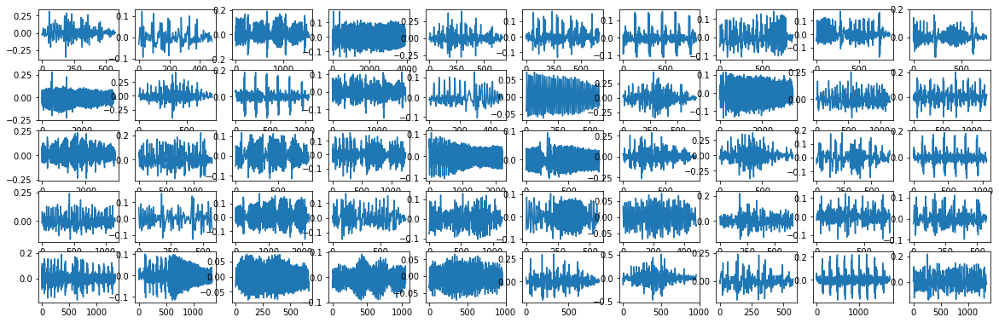

In [20]:
nrows = 5
ncols = 10
zoom = 2
fig, axs = plt.subplots(ncols=ncols, nrows = nrows,figsize = (ncols*zoom, nrows+zoom/1.5))
for i, syll in tqdm(enumerate(sylls), total = nrows*ncols):
    ax = axs.flatten()[i]
    ax.plot(syll)
    if i == nrows*ncols -1:
        break

In [21]:
syllable_df['audio'] = [i/np.max(i) for i in syllable_df.audio.values]

### Create spectrograms

In [22]:
from avgn.visualization.spectrogram import draw_spec_set
from avgn.signalprocessing.create_spectrogram_dataset import make_spec, mask_spec, log_resize_spec, pad_spectrogram

In [23]:
syllables_wav = syllable_df.audio.values
syllables_rate = syllable_df.rate.values

In [24]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    # create spectrograms
    syllables_spec = parallel(
        delayed(make_spec)(
            syllable,
            rate,
            hparams=dataset.hparams,
            mel_matrix=dataset.mel_matrix,
            use_mel=True,
            use_tensorflow=False,
        )
        for syllable, rate in tqdm(
            zip(syllables_wav, syllables_rate),
            total=len(syllables_rate),
            desc="getting syllable spectrograms",
            leave=False,
        )
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Batch computation too fast (0.0486s.) Setting batch_size=8.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1214s.) Setting batch_size=26.
[Parallel(n_jobs=-1)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 304 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 458 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 900 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1394 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2434 tasks      | elapsed:    0.9s
[Parallel

[Parallel(n_jobs=-1)]: Done 111500 out of 111500 | elapsed:   30.9s finished


### Rescale spectrogram
- using log rescaling

In [25]:
log_scaling_factor = 4

In [26]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
    syllables_spec = parallel(
        delayed(log_resize_spec)(spec, scaling_factor=log_scaling_factor)
        for spec in tqdm(syllables_spec, desc="scaling spectrograms", leave=False)
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Batch computation too fast (0.0151s.) Setting batch_size=26.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1457s.) Setting batch_size=70.
[Parallel(n_jobs=-1)]: Done 100 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 490 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 880 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2556 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3886 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 5216 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6686 tasks      | elapsed:    1.2s
[Paral

[Parallel(n_jobs=-1)]: Done 111500 out of 111500 | elapsed:   14.4s finished


(25.0, 10) (320, 800) 25.0 32 800


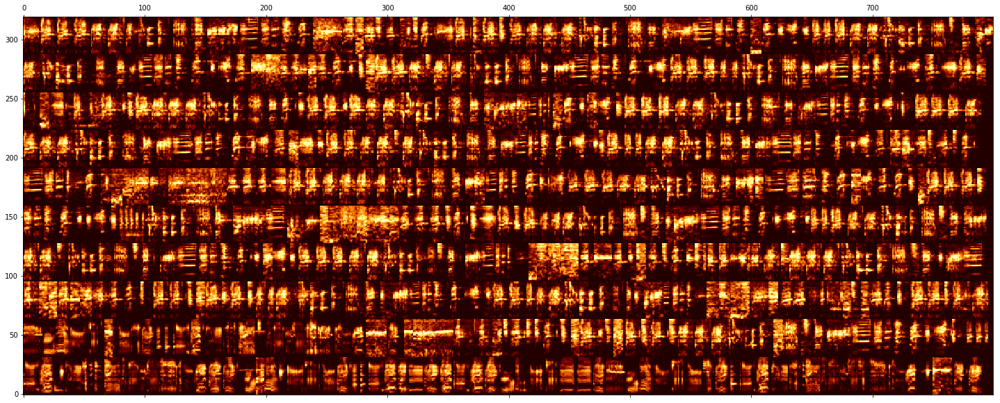

In [27]:
draw_spec_set(syllables_spec[5000:], zoom=1, maxrows=10, colsize=25)

### Pad spectrograms

In [28]:
syll_lens = [np.shape(i)[1] for i in syllables_spec]
pad_length = np.max(syll_lens)

In [29]:
syllable_df[:3]

,start_time,end_time,indv,indvi,key,audio,rate
0,1.17,1.182,WM24,0,WM24_11,"[-0.04728996297326066, -0.08354714715479003, -...",48000
1,1.19,1.200,WM24,0,WM24_11,"[-0.284243243299063, -0.23782483565968338, -0....",48000
2,1.77,1.802,WM24,0,WM24_11,"[0.37414467401997475, 0.05945352182547608, -0....",48000


In [30]:
import seaborn as sns

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


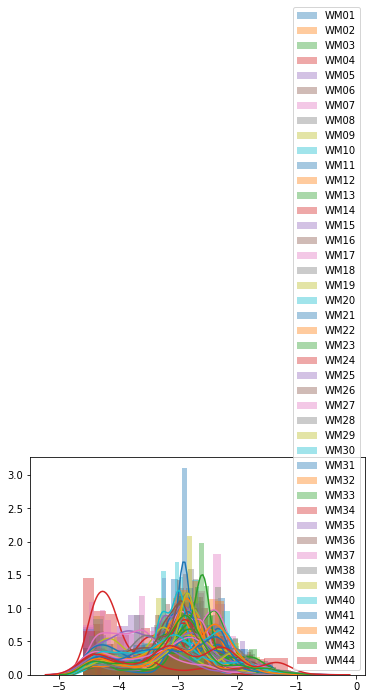

In [31]:
for indv in np.unique(syllable_df.indv):
    sns.distplot(np.log(syllable_df[syllable_df.indv==indv]["end_time"] - syllable_df[syllable_df.indv==indv]["start_time"]), label=indv)
plt.legend()

In [32]:
with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:

    syllables_spec = parallel(
        delayed(pad_spectrogram)(spec, pad_length)
        for spec in tqdm(
            syllables_spec, desc="padding spectrograms", leave=False
        )
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Batch computation too fast (0.0275s.) Setting batch_size=14.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.0710s.) Setting batch_size=78.
[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 286 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 496 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1719s.) Setting batch_size=180.
[Parallel(n_jobs=-1)]: Done 862 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2124 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3606 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 6516 tasks      | el

[Parallel(n_jobs=-1)]: Done 111500 out of 111500 | elapsed:   11.7s finished


In [33]:
def norm(x):
    return (x - np.min(x)) / (np.max(x) - np.min(x))

In [34]:
def remove_med(x):
    x[x<=np.median(x)] = 0
    return x

In [35]:
syllables_spec = [(norm(i)*255).astype('uint8') for i in tqdm(syllables_spec)]
syllables_spec = [remove_med(i) for i in tqdm(syllables_spec)]

(25.0, 10) (320, 800) 25.0 32 800


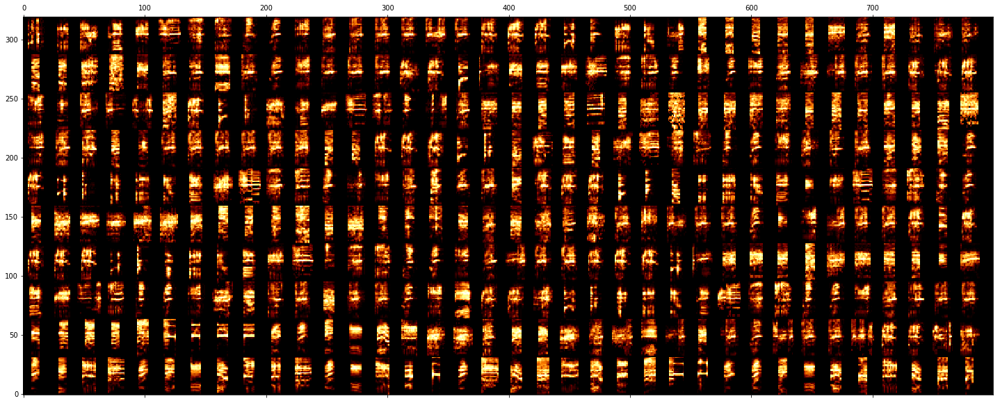

In [36]:
draw_spec_set(syllables_spec, zoom=1, maxrows=10, colsize=25)

In [37]:
np.shape(syllables_spec)

(111500, 32, 22)

In [38]:
syllable_df['spectrogram'] = syllables_spec

In [39]:
syllable_df[:3]

,start_time,end_time,indv,indvi,key,audio,rate,spectrogram
0,1.17,1.182,WM24,0,WM24_11,"[-0.04728996297326066, -0.08354714715479003, -...",48000,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."
1,1.19,1.200,WM24,0,WM24_11,"[-0.284243243299063, -0.23782483565968338, -0....",48000,"[[0, 0, 0, 0, 0, 0, 0, 19, 9, 2, 0, 0, 3, 5, 0..."
2,1.77,1.802,WM24,0,WM24_11,"[0.37414467401997475, 0.05945352182547608, -0....",48000,"[[0, 0, 0, 0, 0, 0, 7, 7, 0, 0, 0, 0, 0, 0, 0,..."


### view syllables per indv

In [40]:
syllable_df.indv.unique()

array(['WM24', 'WM33', 'WM19', 'WM27', 'WM25', 'WM44', 'WM31', 'WM06',
       'WM37', 'WM30', 'WM26', 'WM10', 'WM36', 'WM03', 'WM15', 'WM28',
       'WM32', 'WM39', 'WM04', 'WM29', 'WM34', 'WM12', 'WM09', 'WM35',
       'WM38', 'WM23', 'WM14', 'WM42', 'WM02', 'WM07', 'WM21', 'WM16',
       'WM40', 'WM18', 'WM43', 'WM22', 'WM41', 'WM01', 'WM17', 'WM20',
       'WM11', 'WM13', 'WM08', 'WM05'], dtype=object)

WM01 2389
(50.0, 32) (512, 800) 25.0 32 800


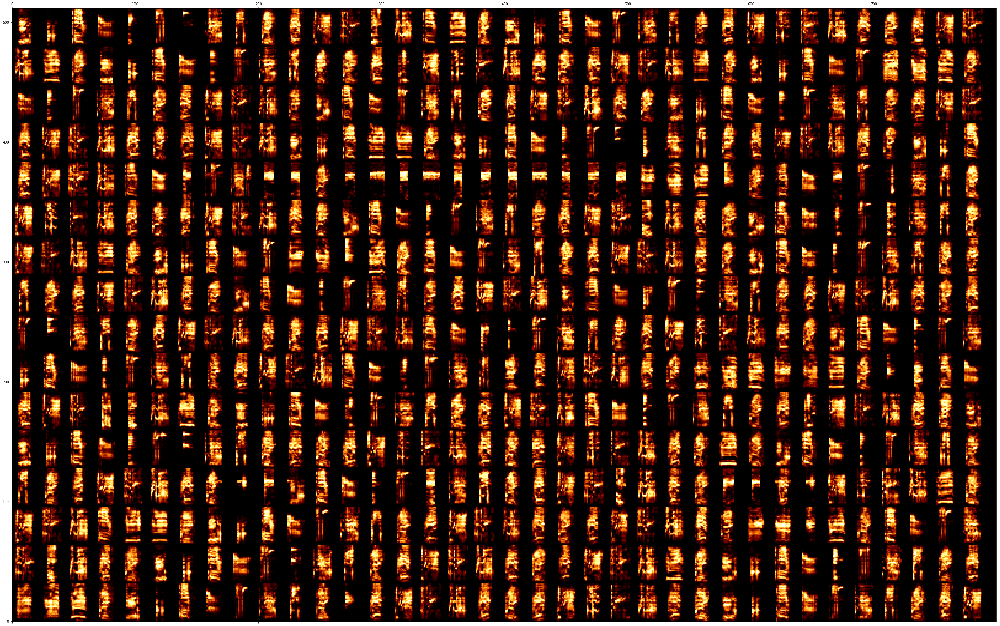

WM02 1966
(50.0, 32) (512, 800) 25.0 32 800


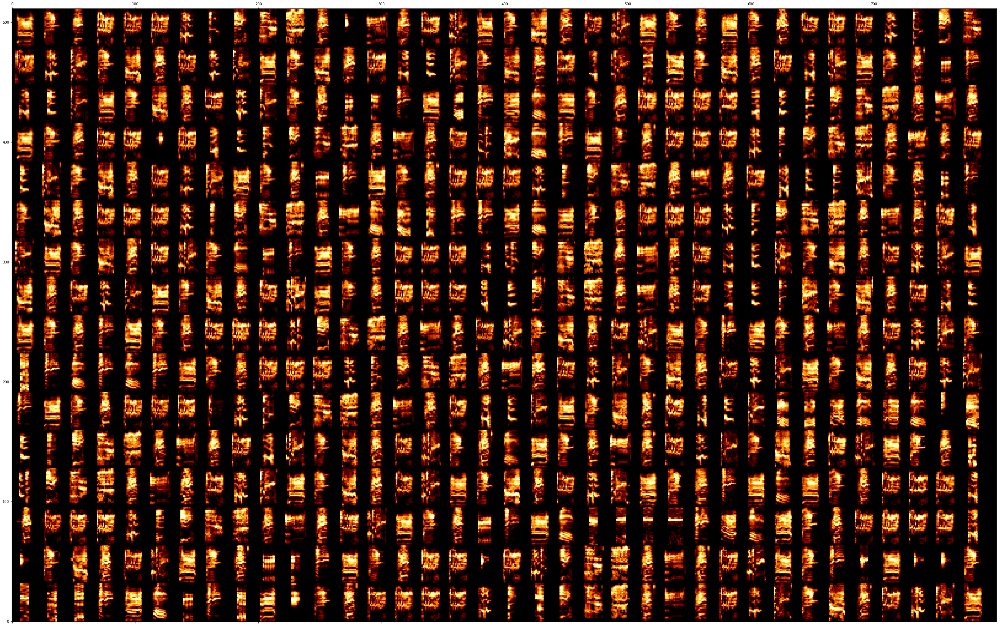

WM03 2446
(50.0, 32) (512, 800) 25.0 32 800


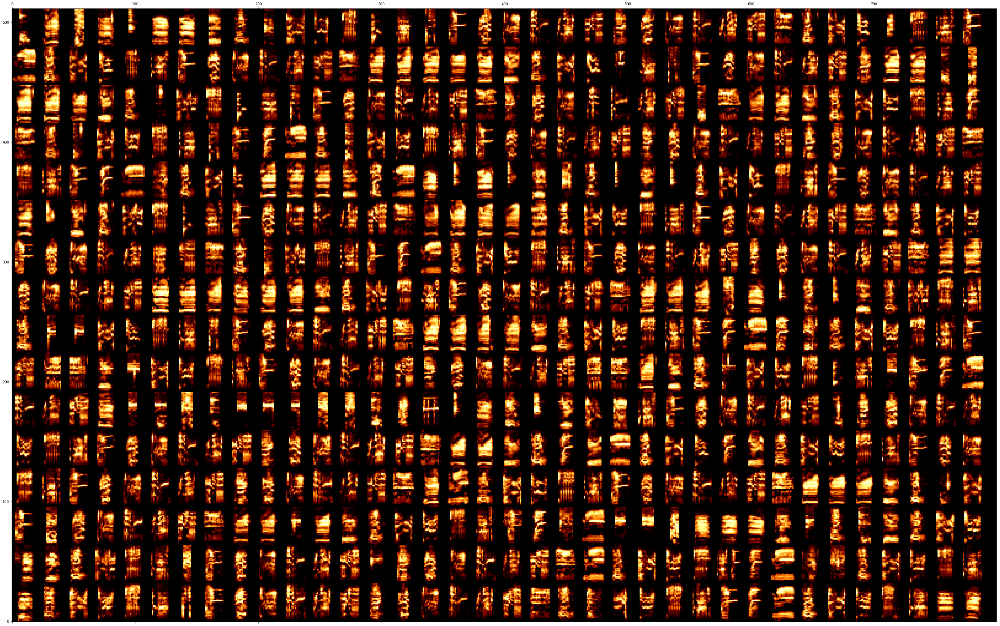

WM04 2346
(50.0, 32) (512, 800) 25.0 32 800


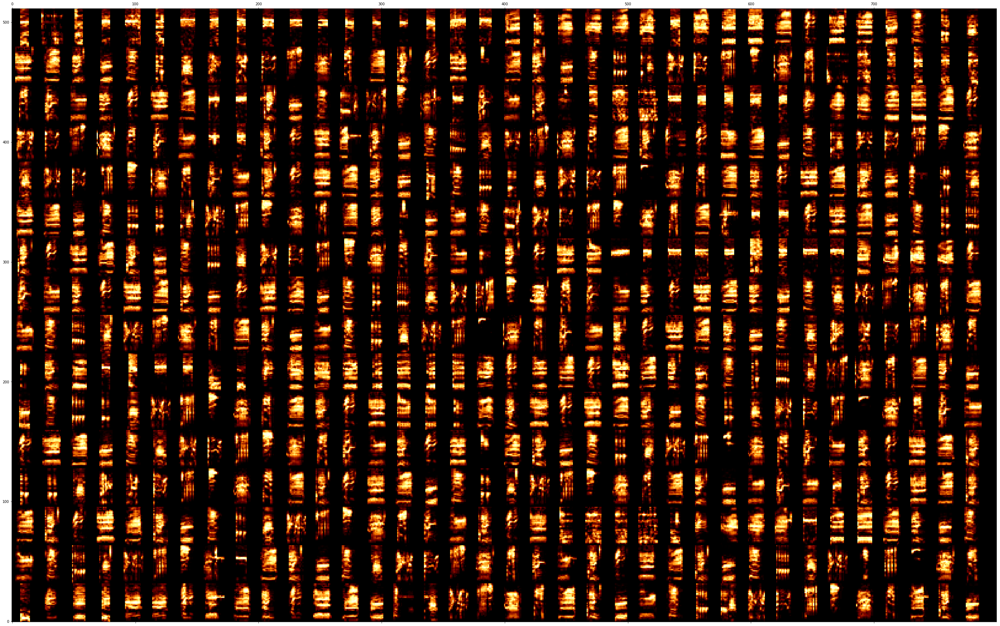

WM05 2062
(50.0, 32) (512, 800) 25.0 32 800


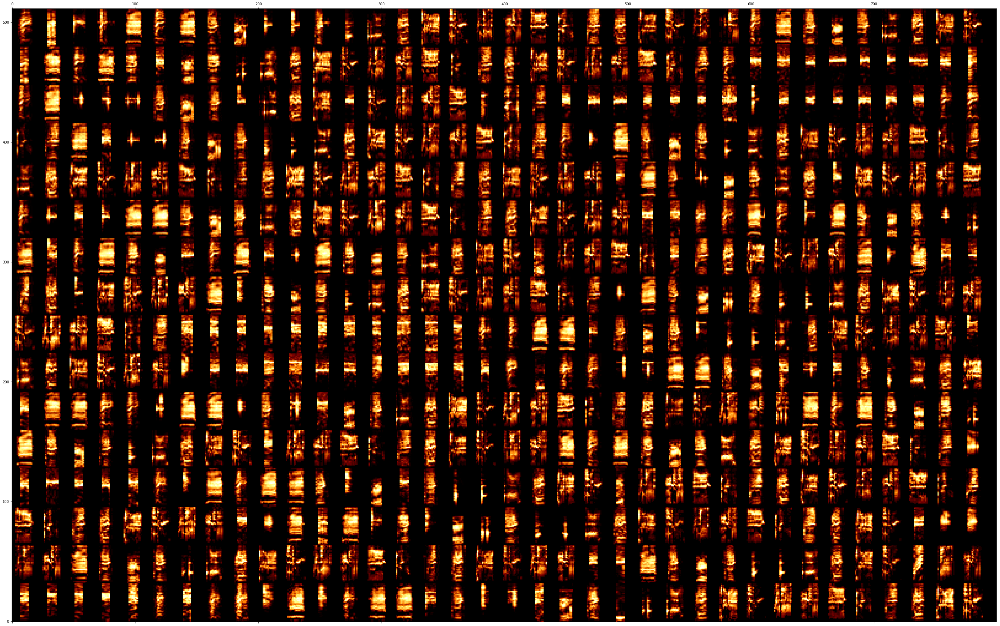

WM06 1669
(50.0, 32) (512, 800) 25.0 32 800


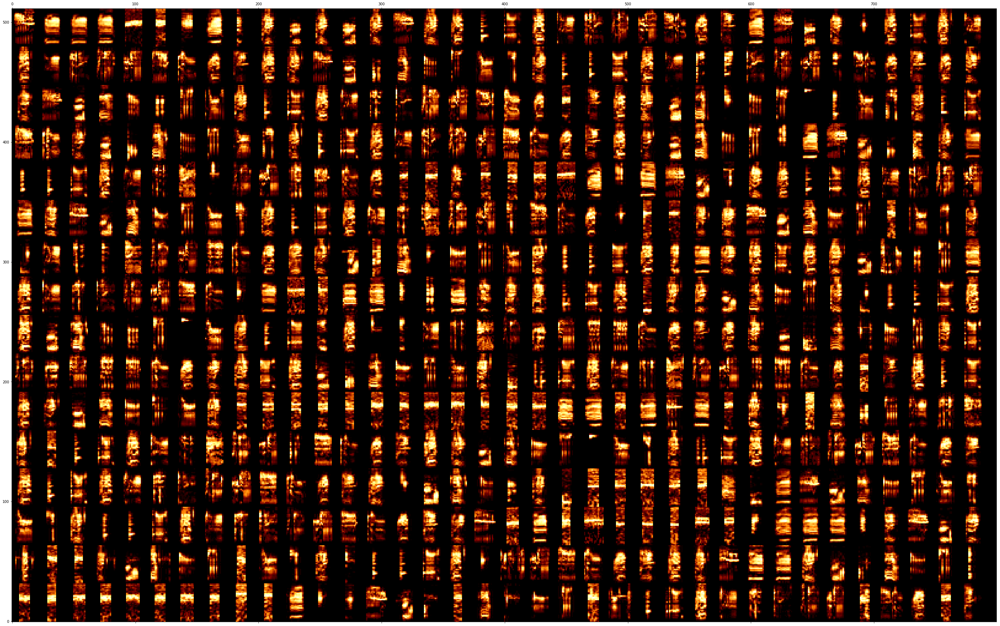

WM07 1898
(50.0, 32) (512, 800) 25.0 32 800


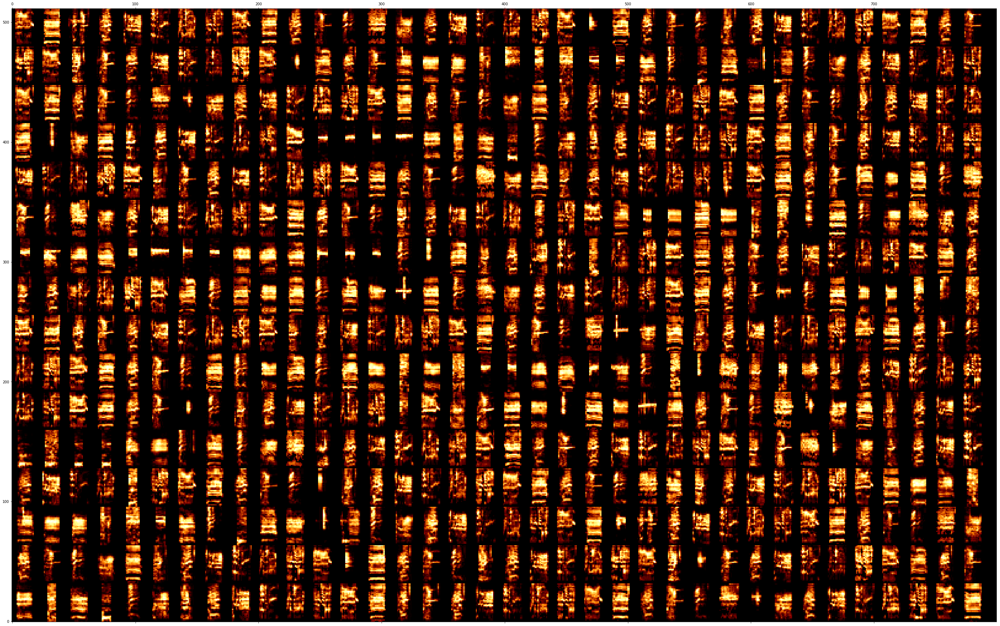

WM08 2224
(50.0, 32) (512, 800) 25.0 32 800


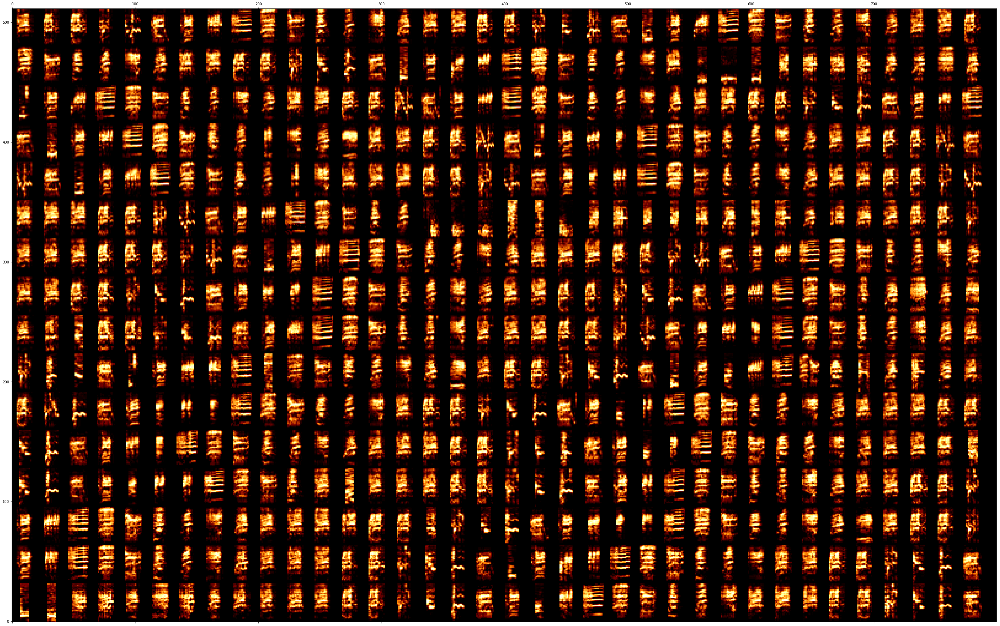

WM09 1306
(50.0, 32) (512, 800) 25.0 32 800


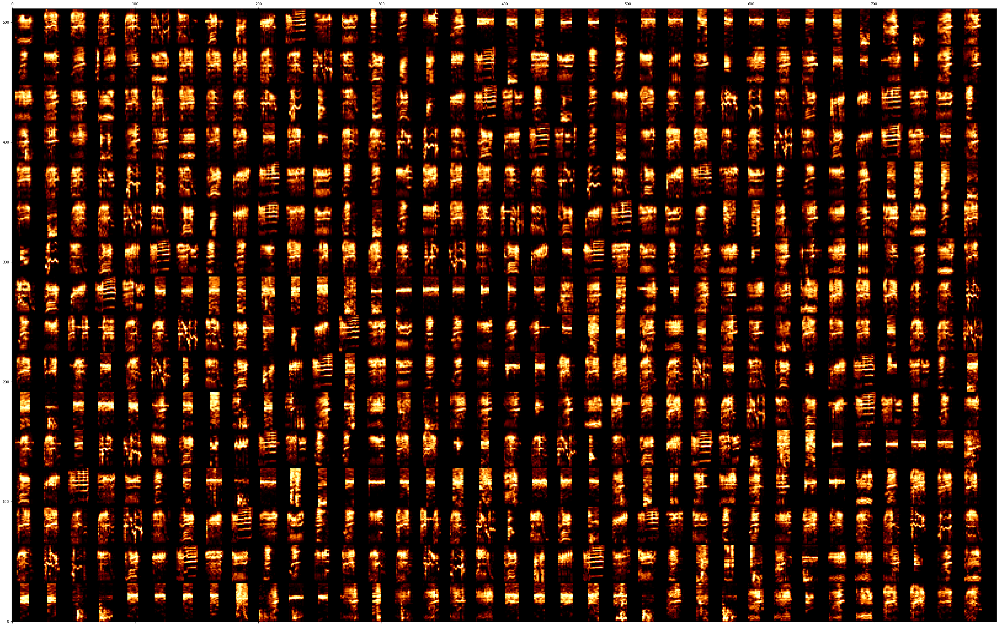

WM10 2068
(50.0, 32) (512, 800) 25.0 32 800


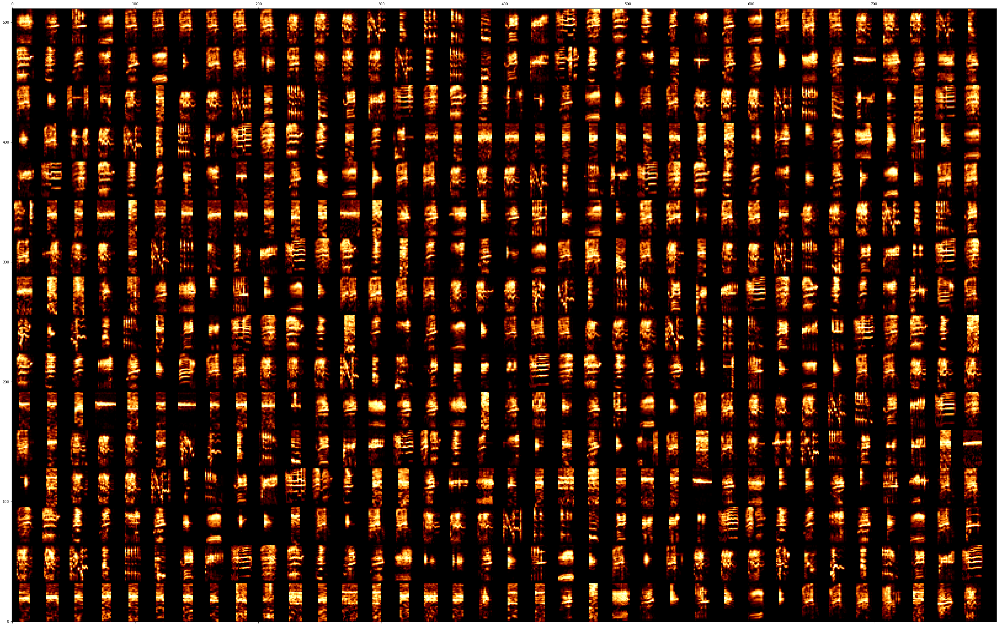

WM11 2664
(50.0, 32) (512, 800) 25.0 32 800


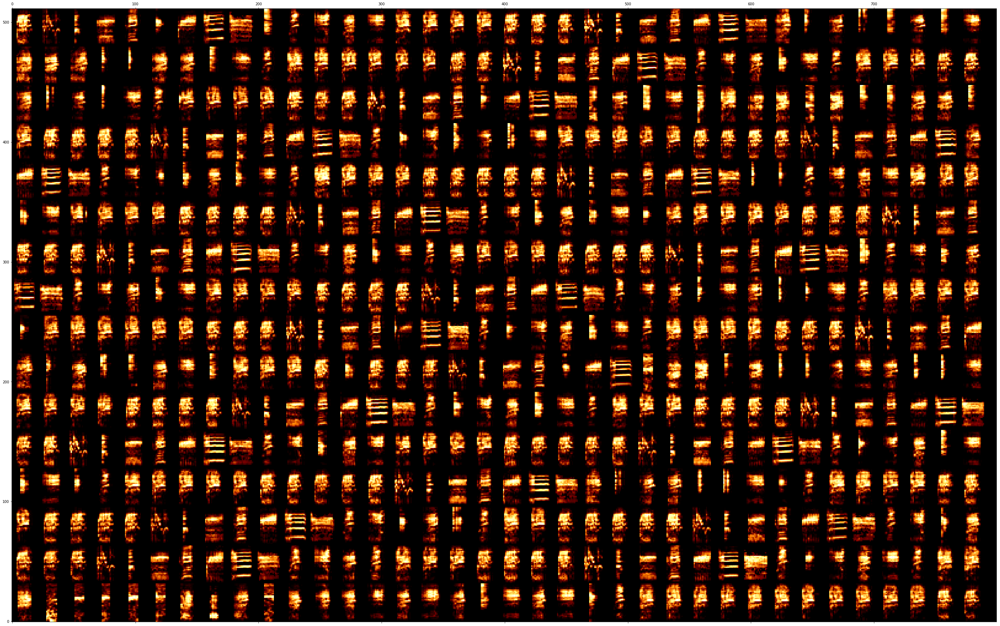

WM12 1799
(50.0, 32) (512, 800) 25.0 32 800


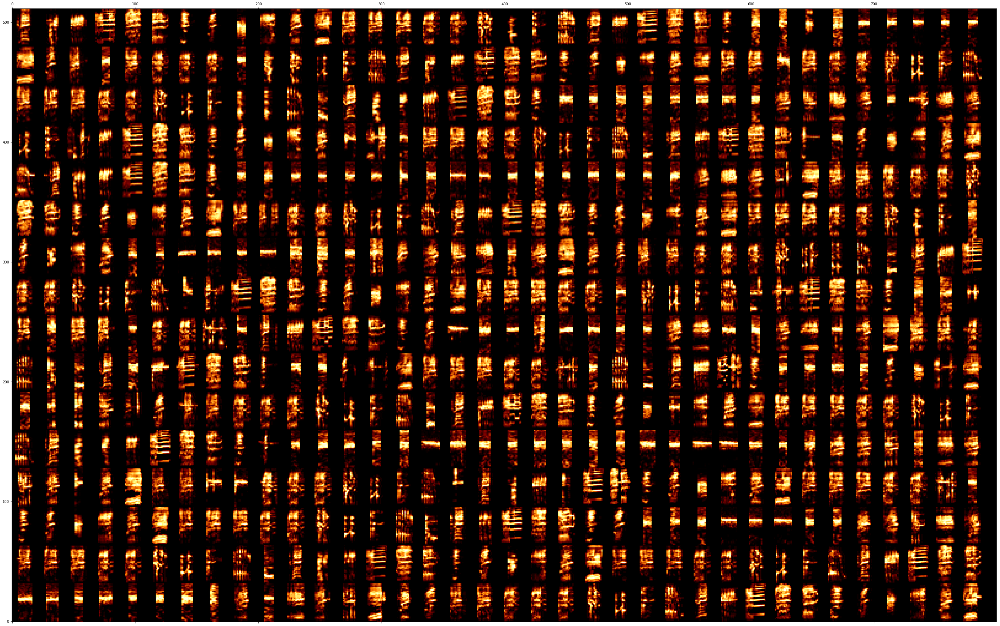

WM13 1538
(50.0, 32) (512, 800) 25.0 32 800


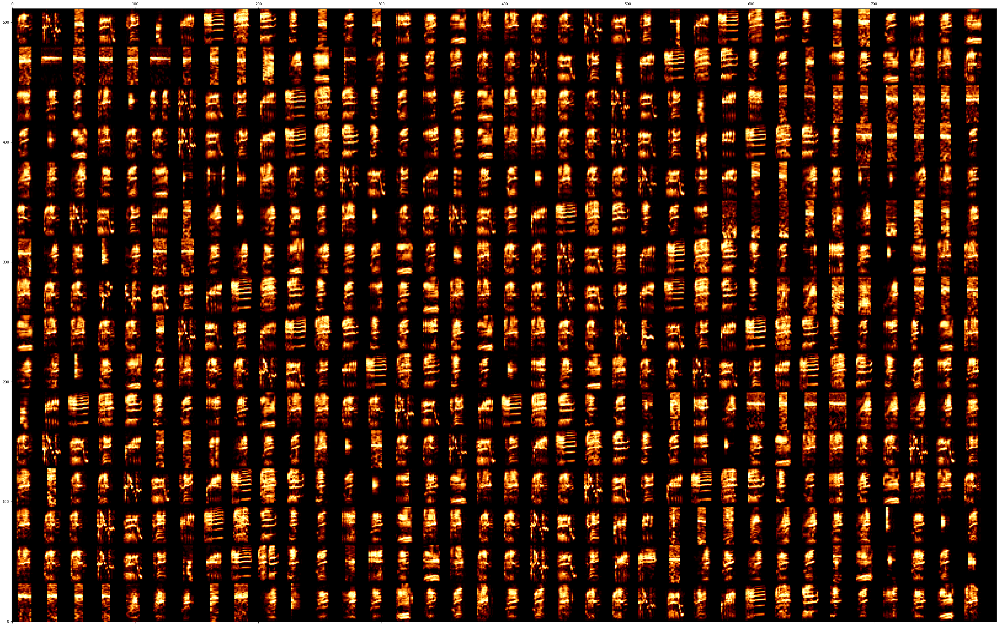

WM14 1533
(50.0, 32) (512, 800) 25.0 32 800


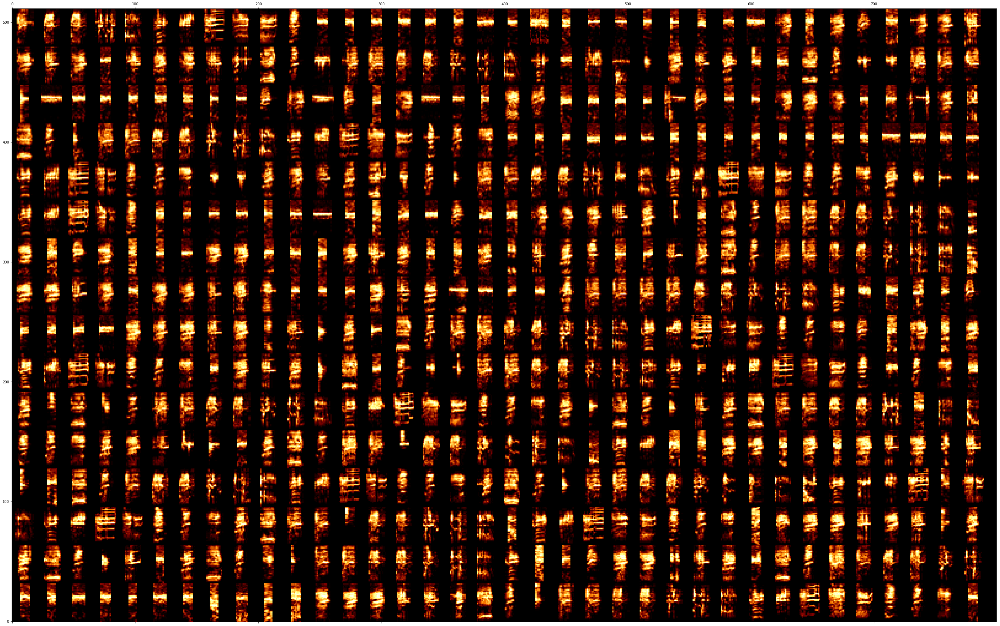

WM15 2234
(50.0, 32) (512, 800) 25.0 32 800


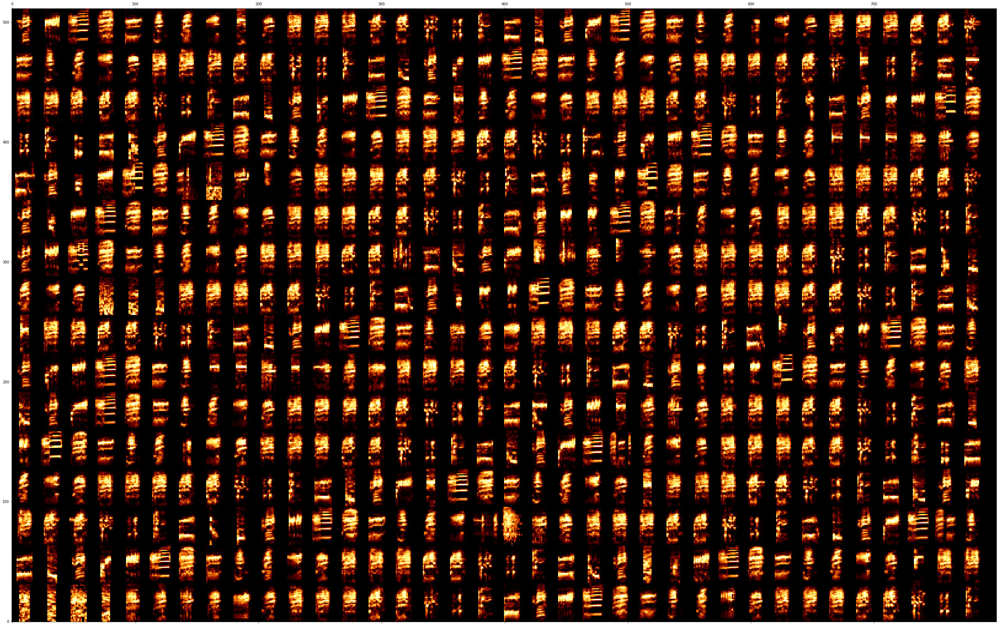

WM16 2515
(50.0, 32) (512, 800) 25.0 32 800


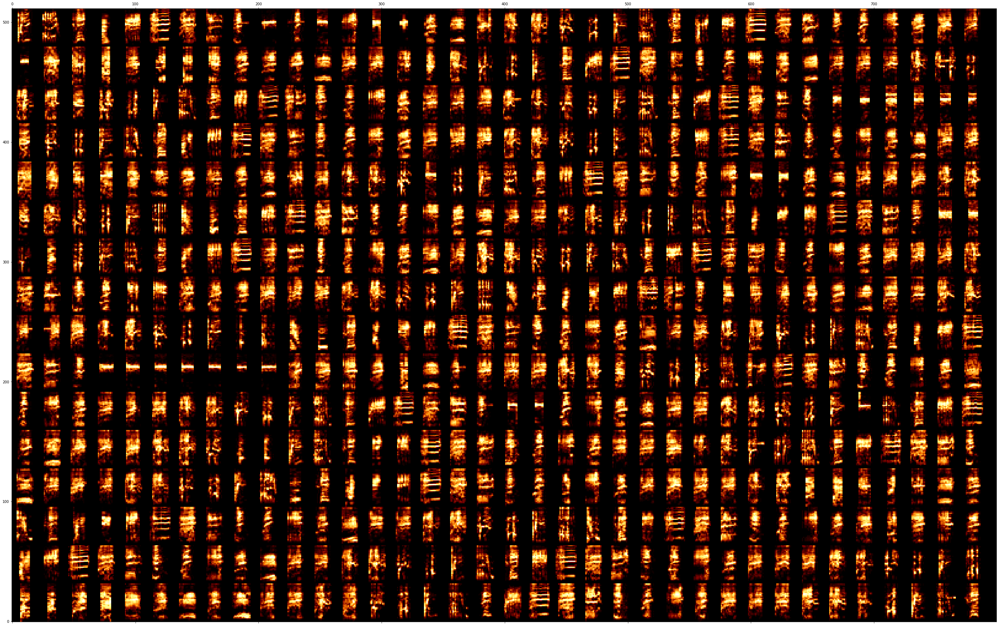

WM17 1674
(50.0, 32) (512, 800) 25.0 32 800


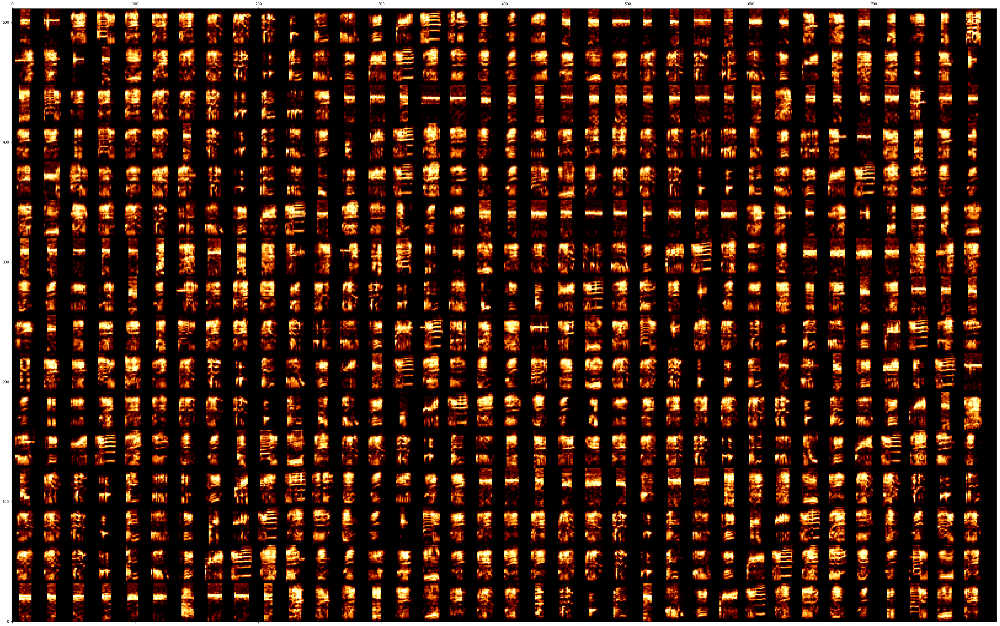

WM18 1353
(50.0, 32) (512, 800) 25.0 32 800


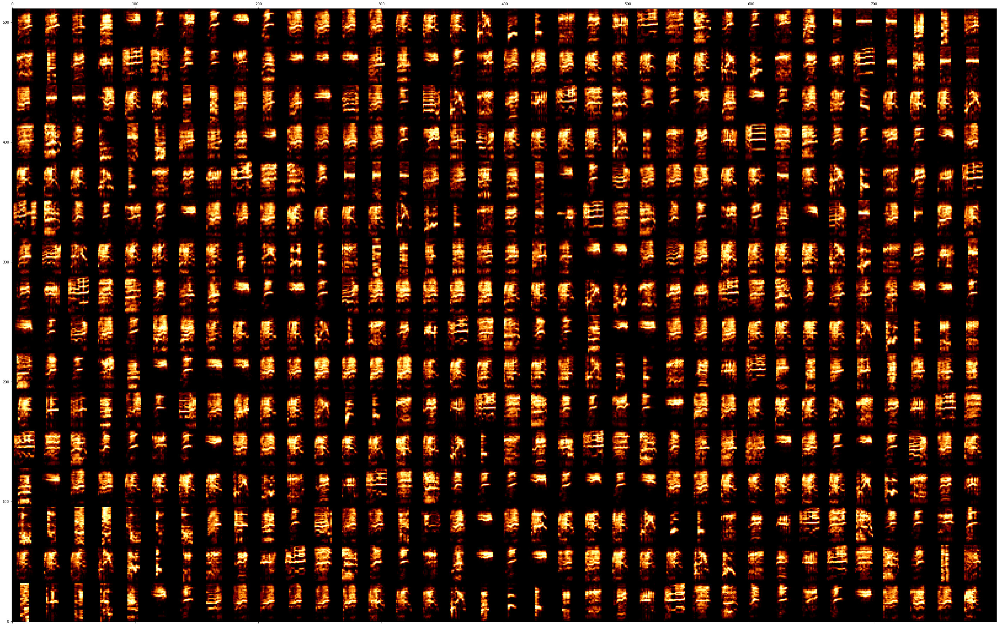

WM19 1285
(50.0, 32) (512, 800) 25.0 32 800


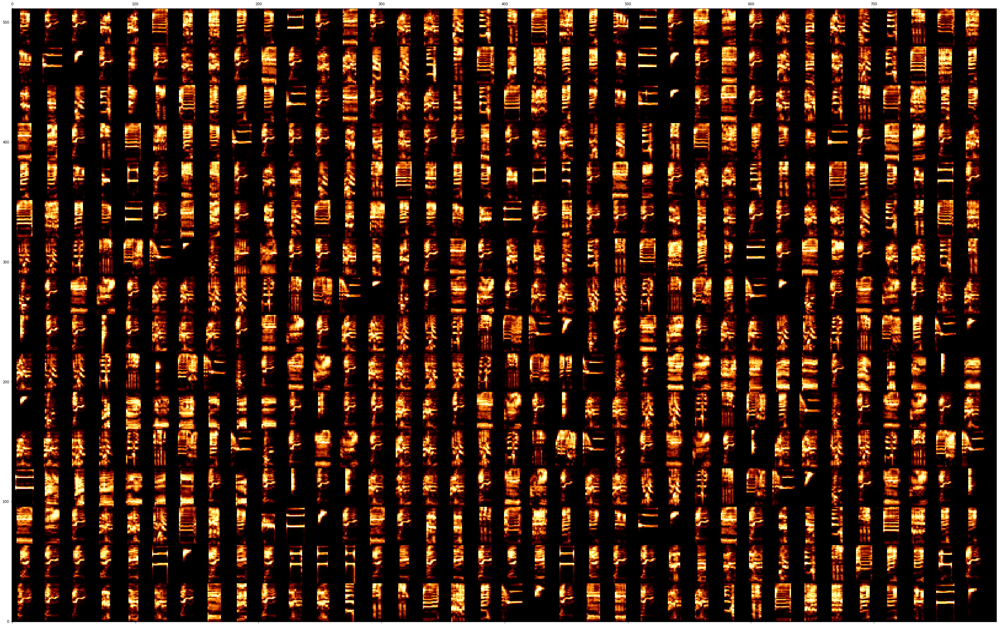

WM20 1712
(50.0, 32) (512, 800) 25.0 32 800


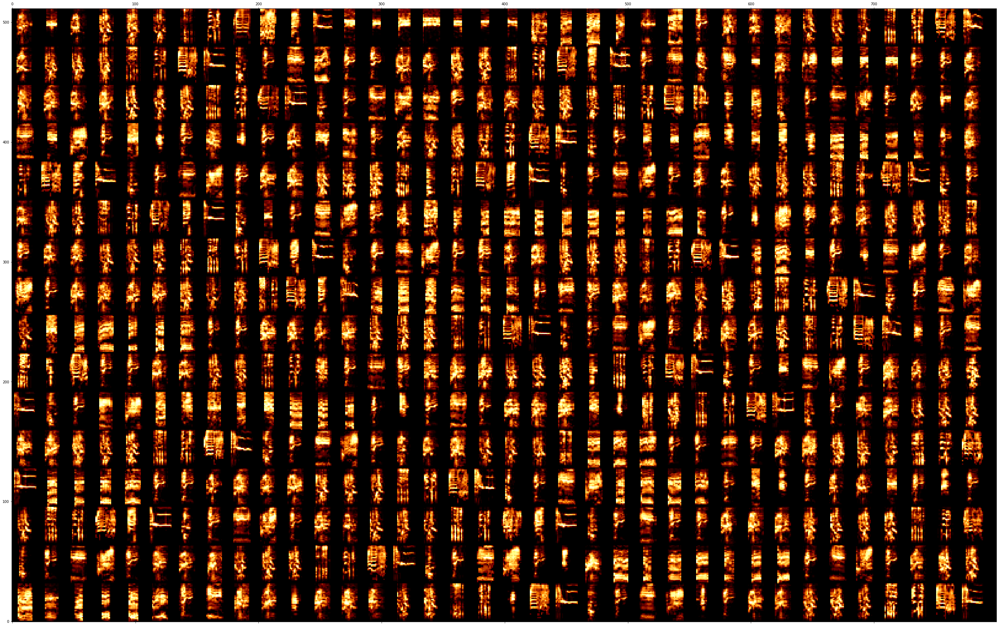

WM21 2542
(50.0, 32) (512, 800) 25.0 32 800


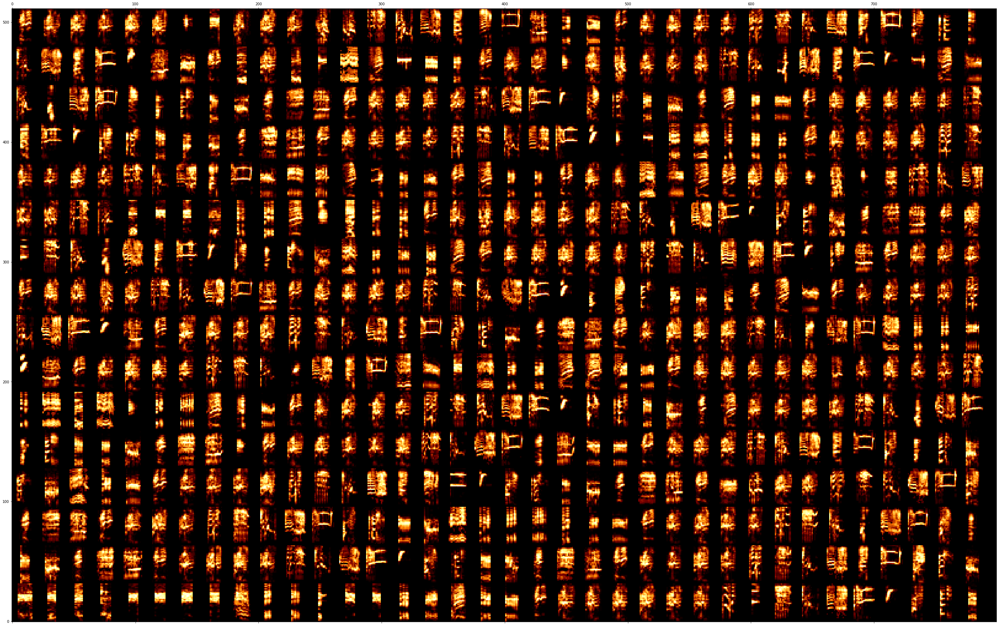

WM22 790
(50.0, 32) (512, 800) 25.0 32 800


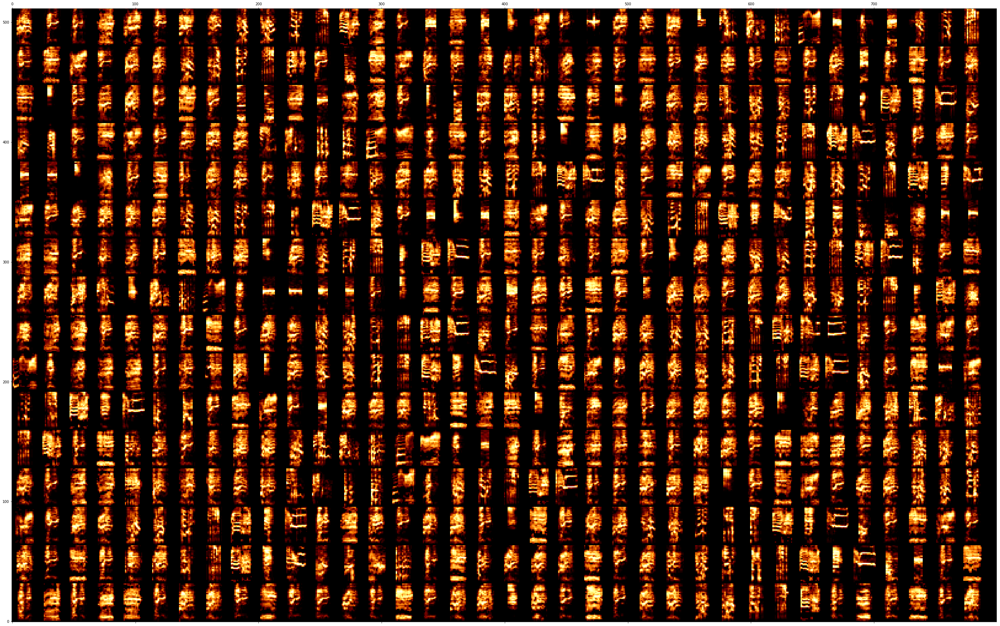

WM23 1663
(50.0, 32) (512, 800) 25.0 32 800


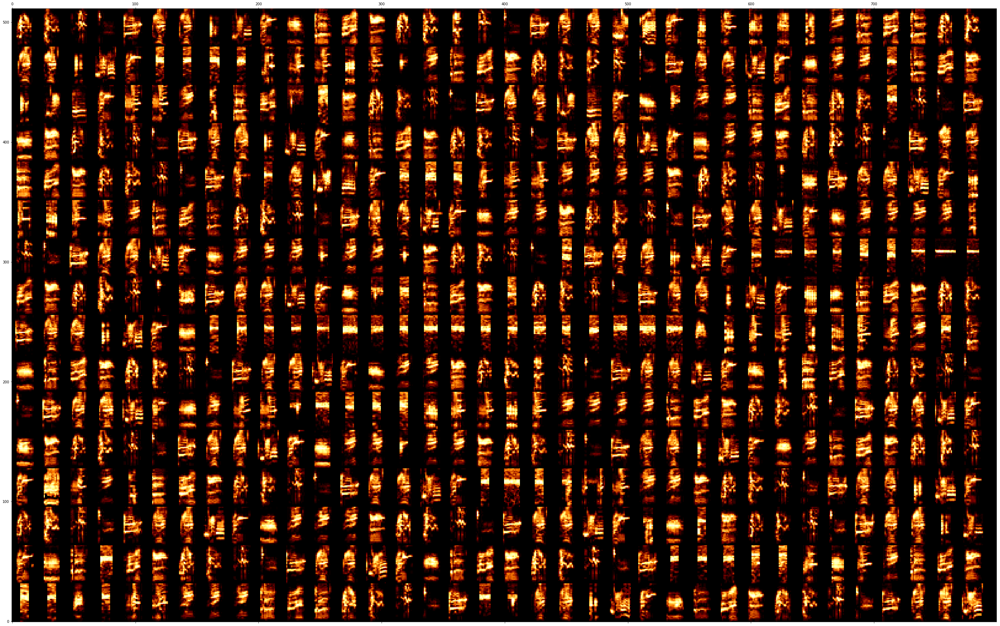

WM24 147
(50.0, 10) (160, 800) 25.0 32 800


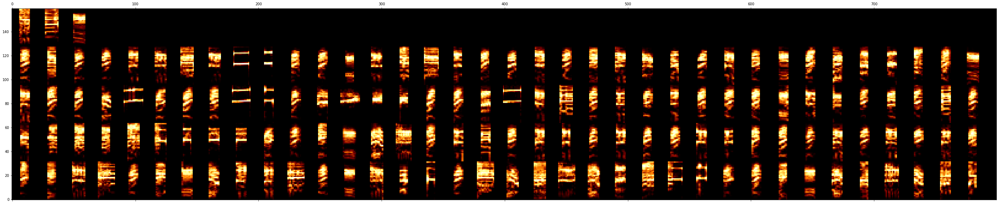

WM25 598
(50.0, 32) (512, 800) 25.0 32 800


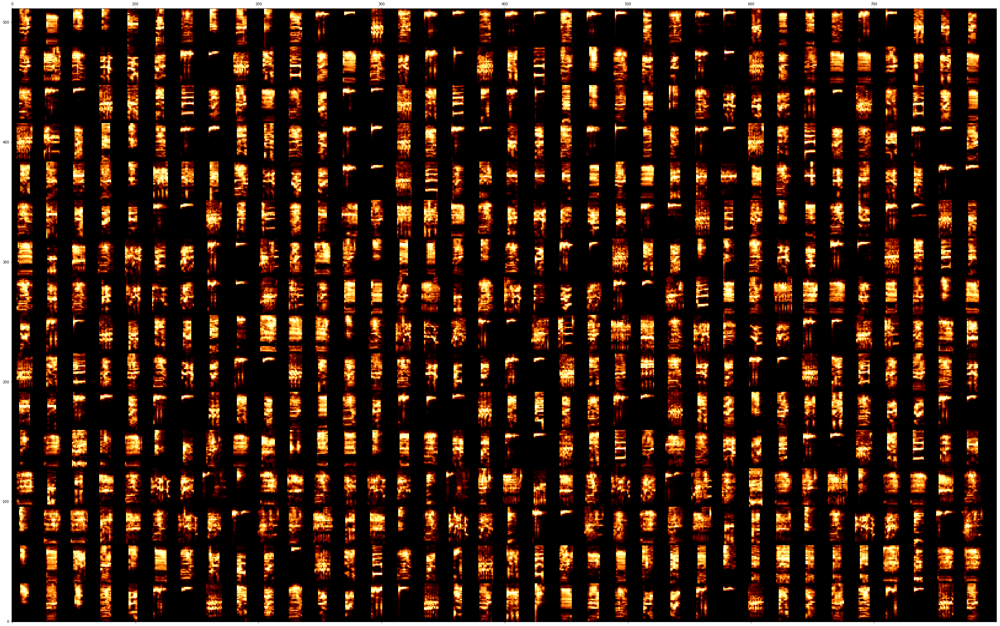

WM26 3551
(50.0, 32) (512, 800) 25.0 32 800


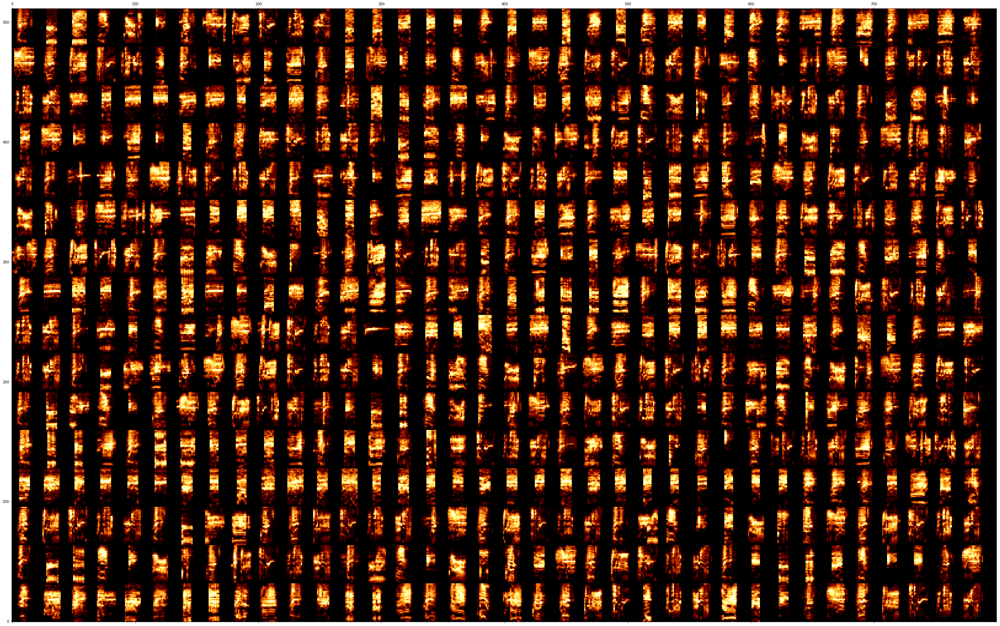

WM27 3734
(50.0, 32) (512, 800) 25.0 32 800


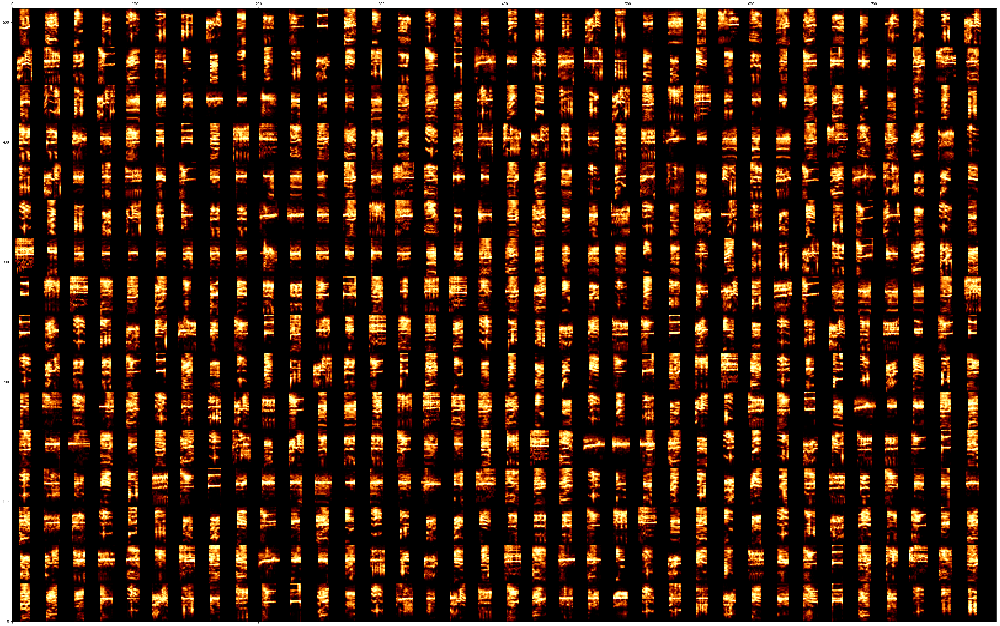

WM28 1902
(50.0, 32) (512, 800) 25.0 32 800


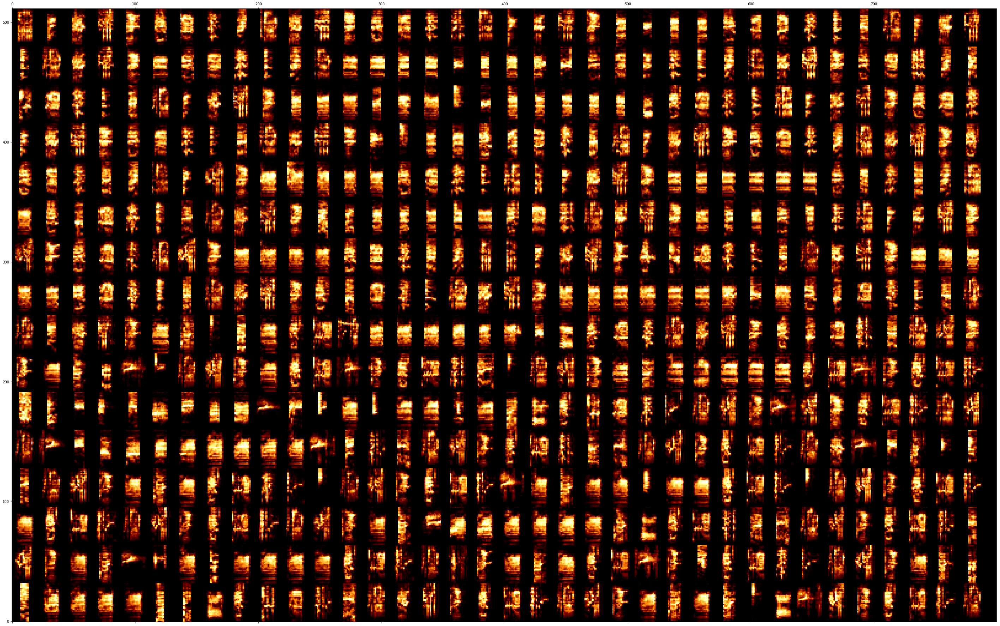

WM29 3160
(50.0, 32) (512, 800) 25.0 32 800


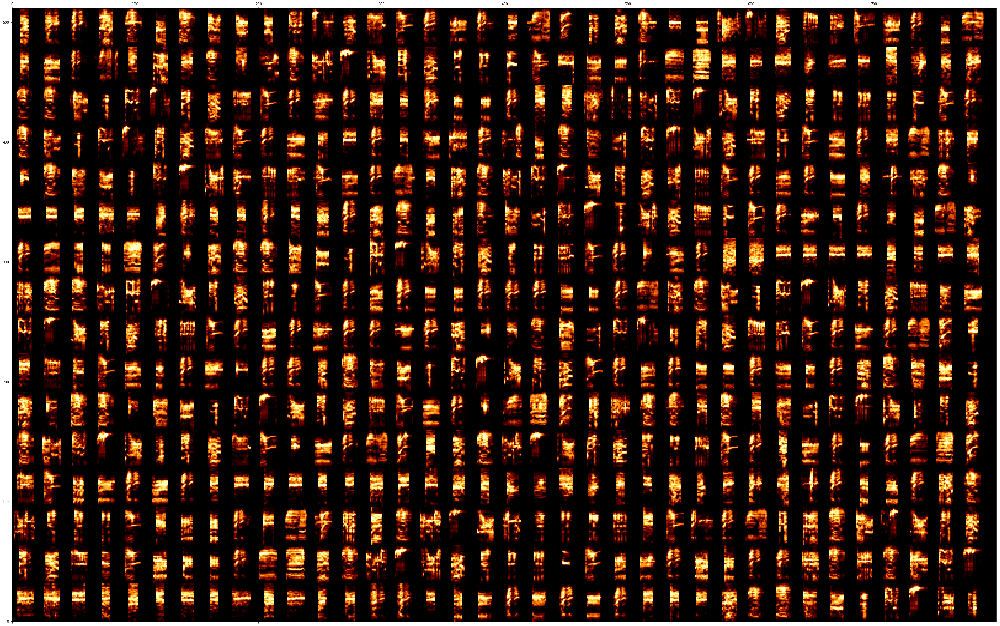

WM30 2077
(50.0, 32) (512, 800) 25.0 32 800


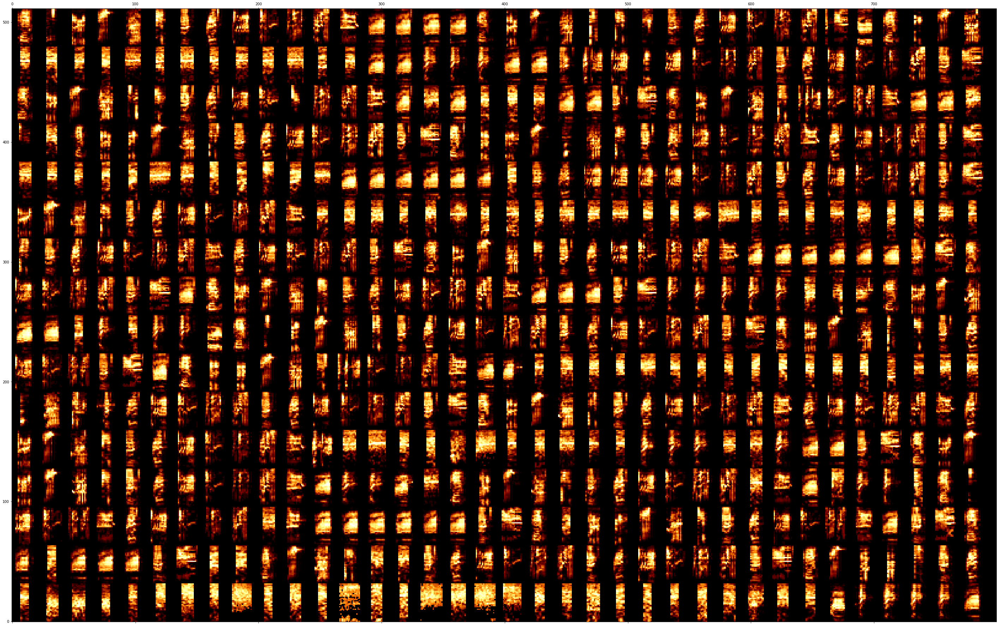

WM31 3468
(50.0, 32) (512, 800) 25.0 32 800


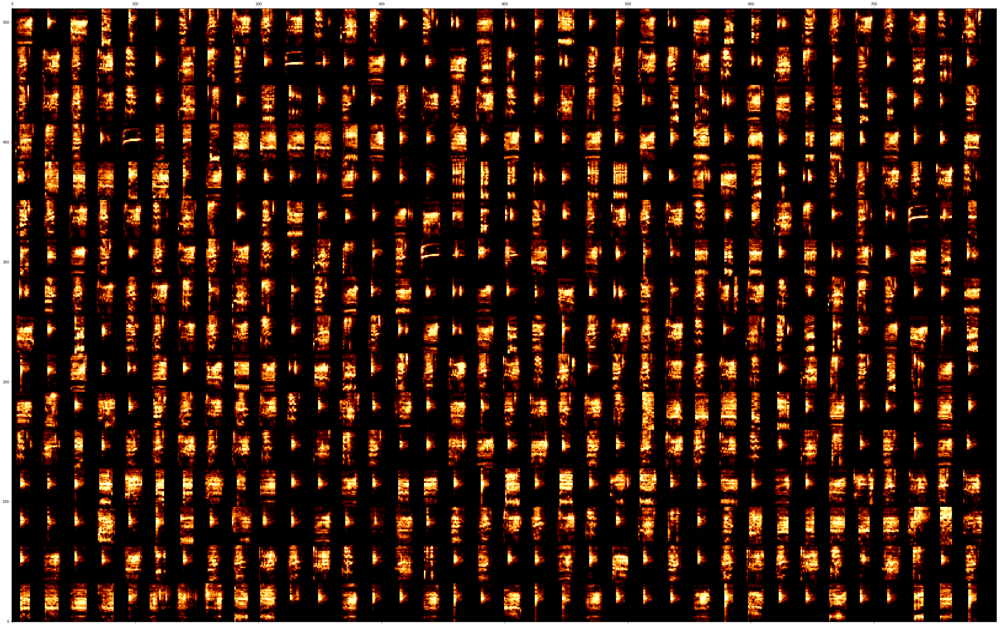

WM32 4946
(50.0, 32) (512, 800) 25.0 32 800


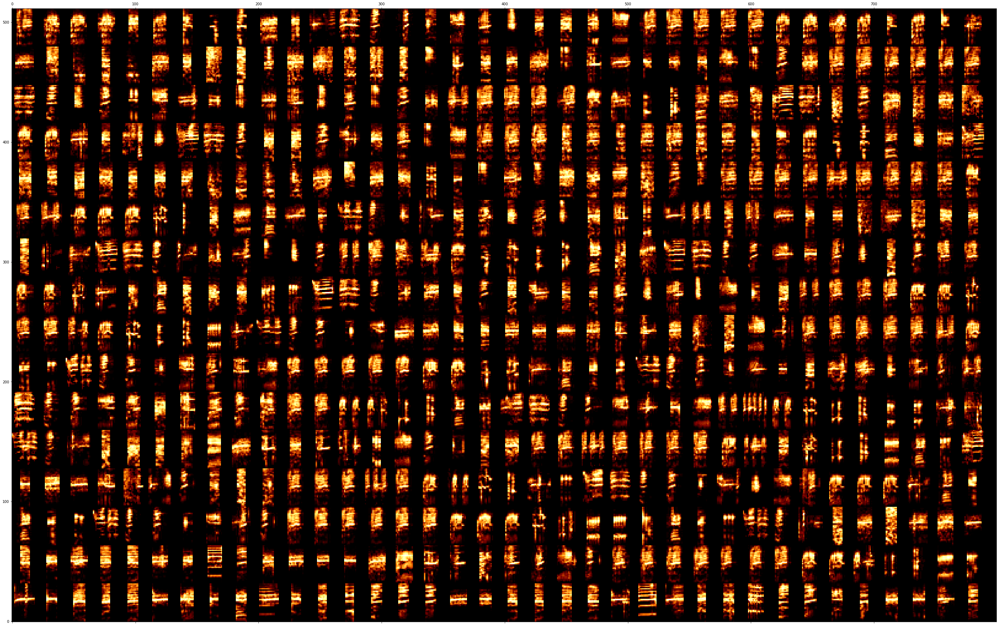

WM33 3308
(50.0, 32) (512, 800) 25.0 32 800


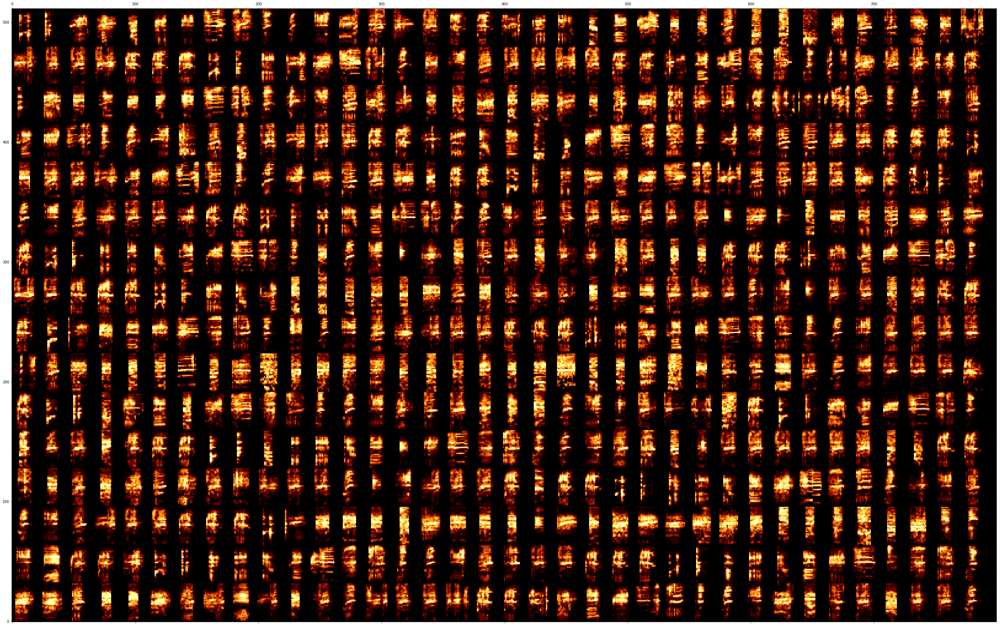

WM34 3039
(50.0, 32) (512, 800) 25.0 32 800


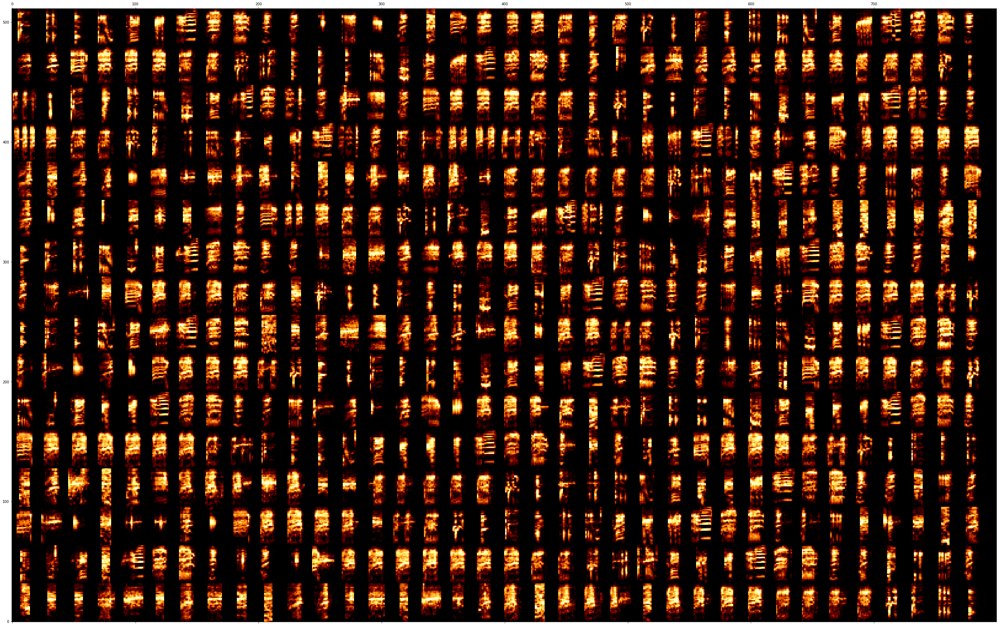

WM35 2290
(50.0, 32) (512, 800) 25.0 32 800


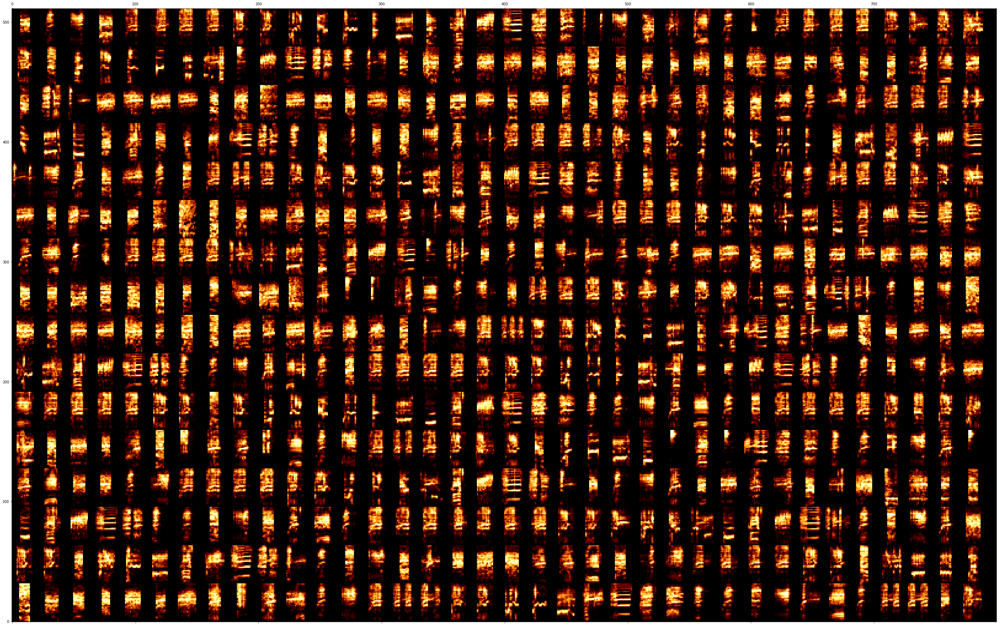

WM36 5117
(50.0, 32) (512, 800) 25.0 32 800


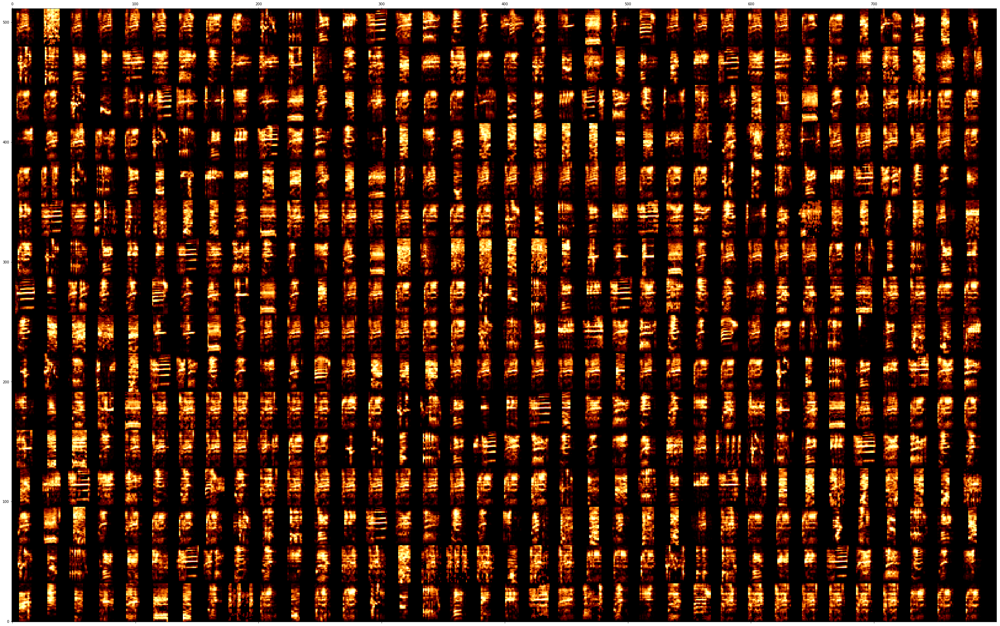

WM37 2214
(50.0, 32) (512, 800) 25.0 32 800


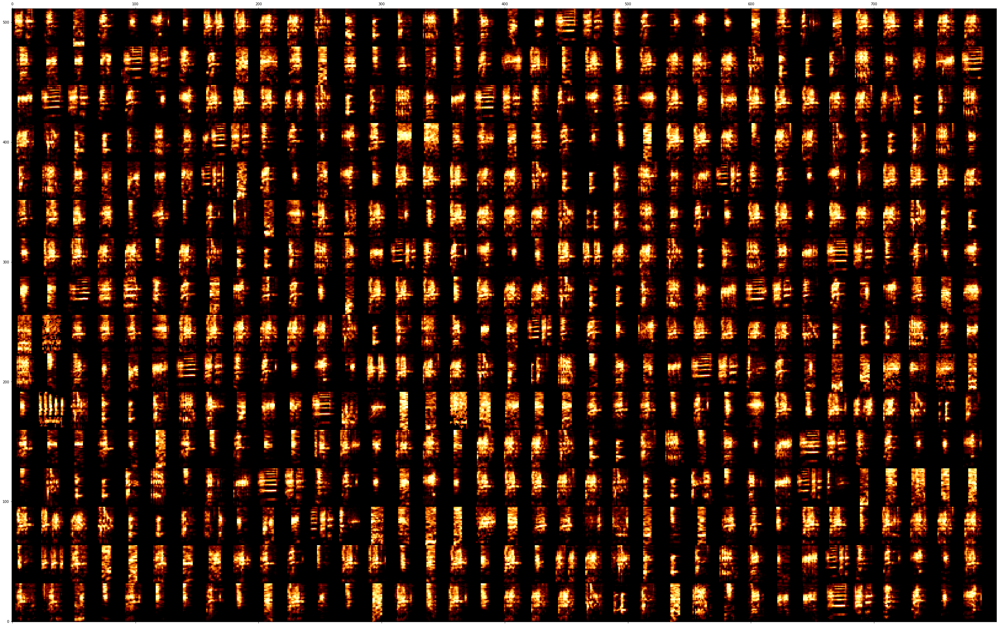

WM38 5647
(50.0, 32) (512, 800) 25.0 32 800


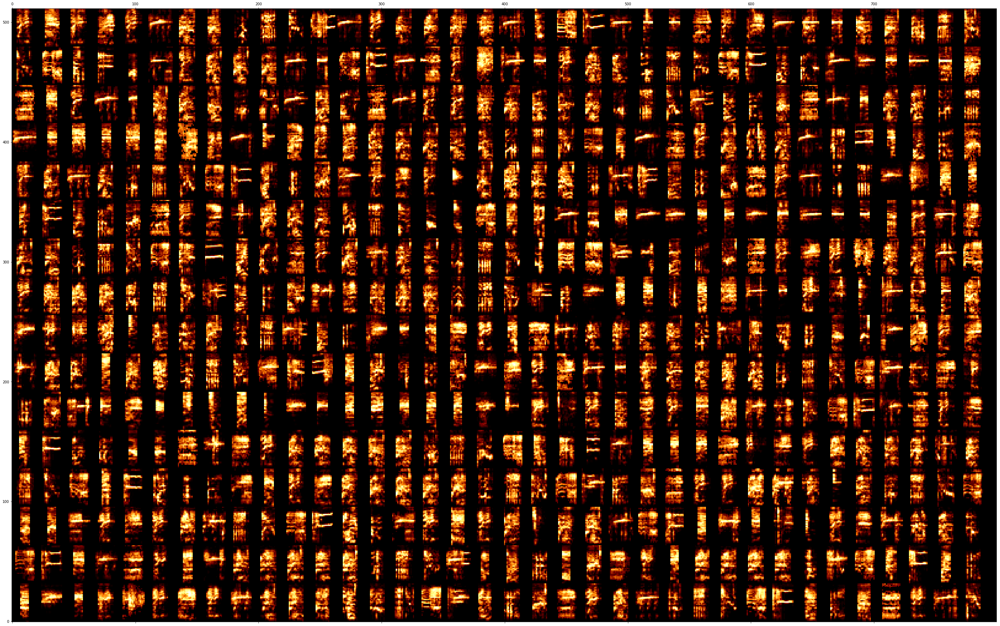

WM39 4580
(50.0, 32) (512, 800) 25.0 32 800


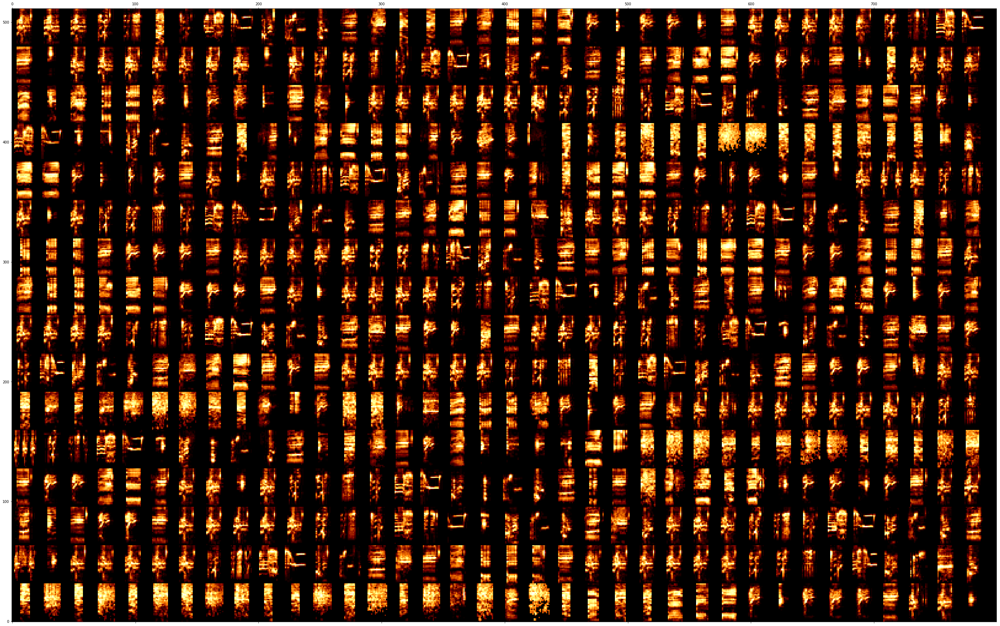

WM40 9190
(50.0, 32) (512, 800) 25.0 32 800


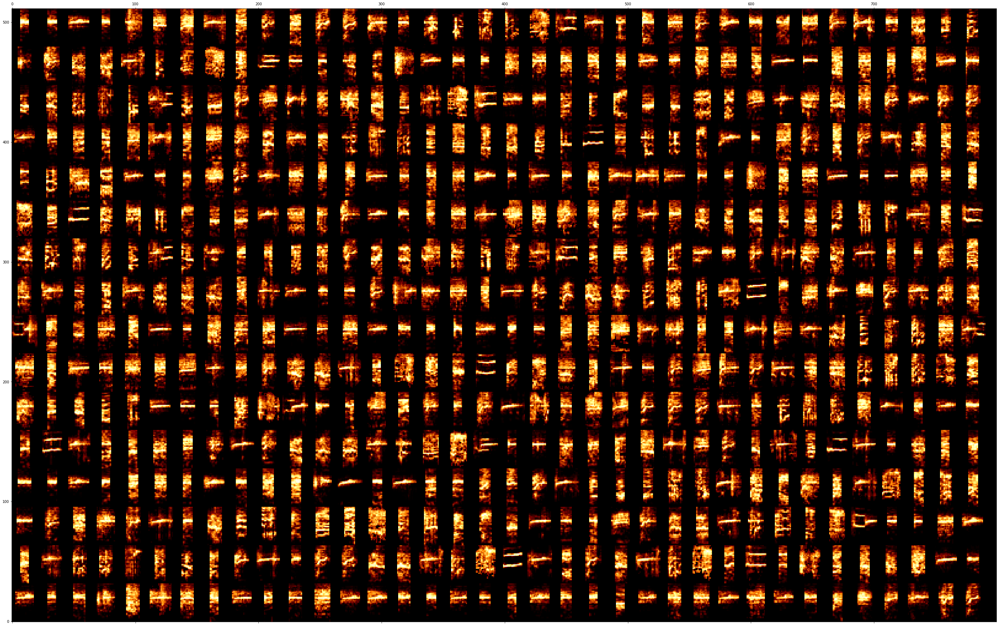

WM41 2073
(50.0, 32) (512, 800) 25.0 32 800


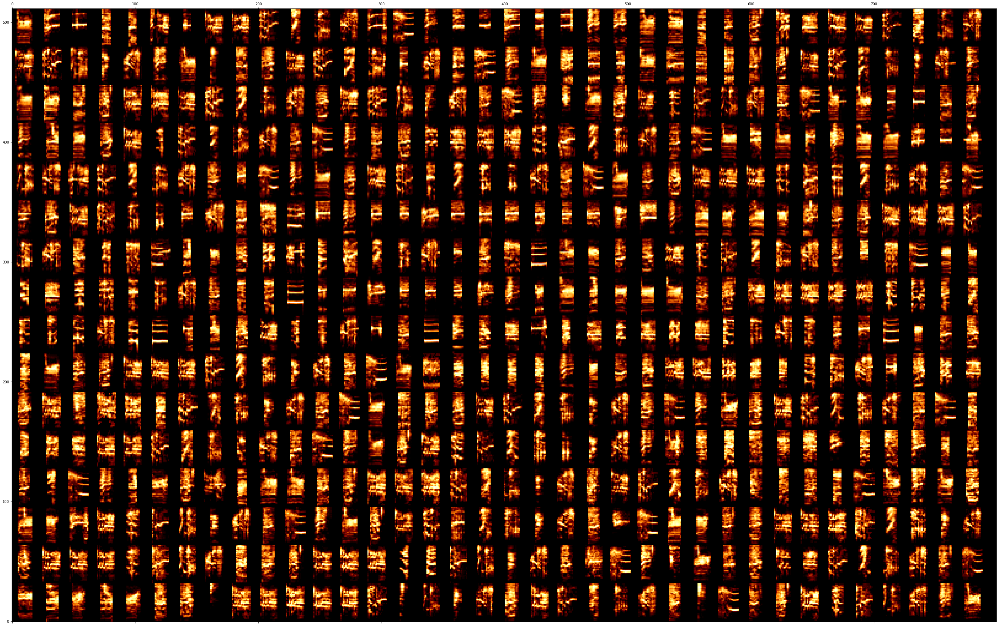

WM42 2393
(50.0, 32) (512, 800) 25.0 32 800


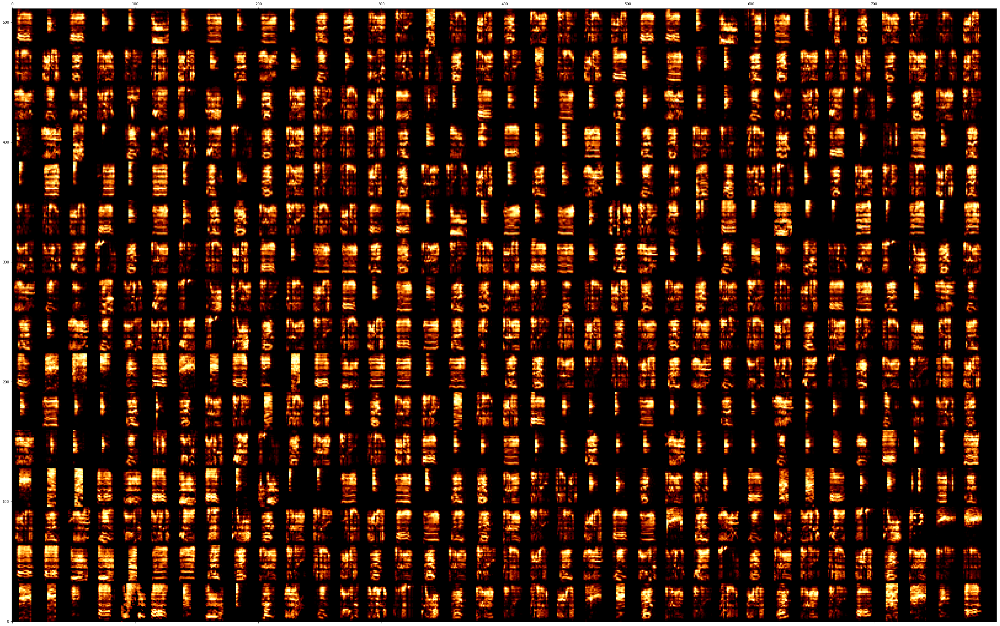

WM43 1501
(50.0, 32) (512, 800) 25.0 32 800


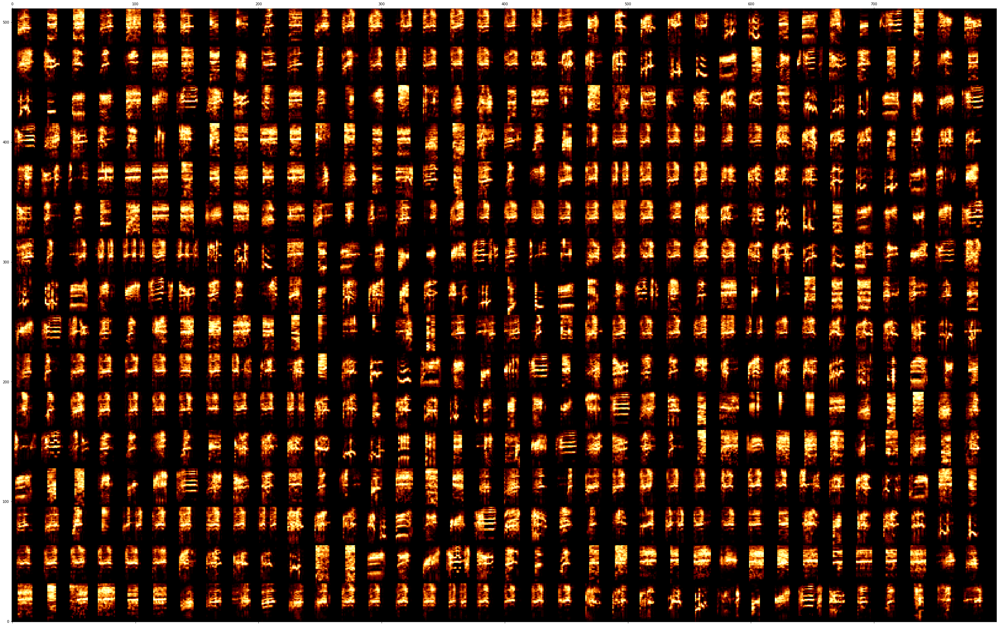

WM44 2889
(50.0, 32) (512, 800) 25.0 32 800


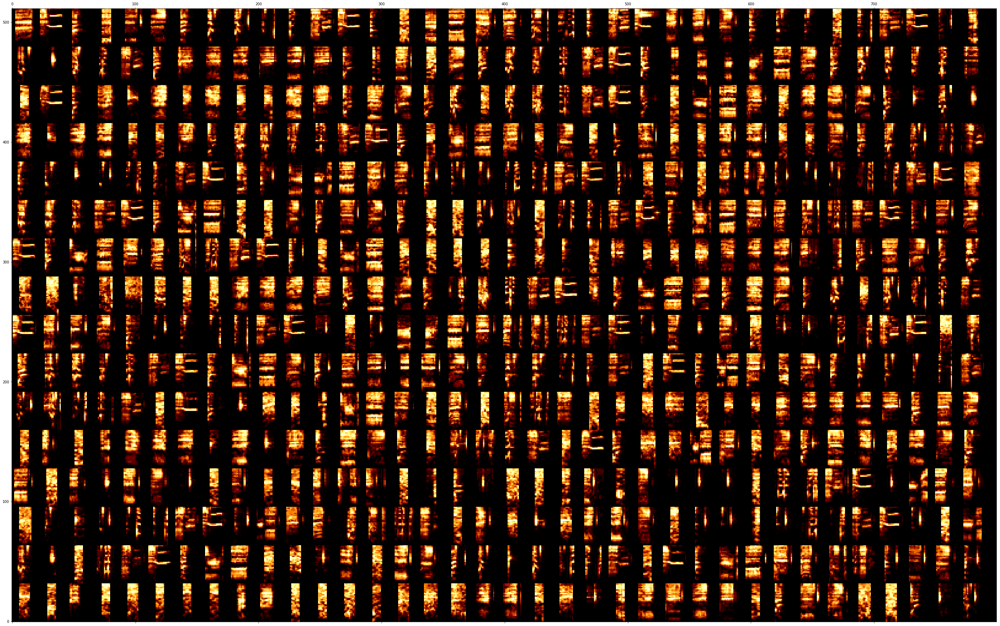

In [41]:
for indv in np.sort(syllable_df.indv.unique()):
    print(indv, np.sum(syllable_df.indv == indv))
    specs = np.array([i/np.max(i) for i in syllable_df[syllable_df.indv == indv].spectrogram.values])
    specs[specs<0] = 0
    draw_spec_set(specs, zoom=2,
                  maxrows=16, 
                  colsize=25)

### save dataset

In [43]:
save_loc = DATA_DIR / 'syllable_dfs' / DATASET_ID / 'munia.pickle'
ensure_dir(save_loc)
syllable_df.to_pickle(save_loc)